In [1]:
import os
import pandas as pd
import numpy as np
import itertools
import matplotlib.pyplot as plt
from collections import Counter
from matplotlib import cm
from matplotlib import colors
import matplotlib.patches as mpatches
import multiprocessing as mp
import matplotlib.image as image
from Bio import SeqIO, Seq
import gzip
import bz2
import seaborn as sns
from glob import glob
from matplotlib import ticker
import matplotlib as mpl
%matplotlib inline
%config InlineBackend.figure_format = 'svg'
plt.rcParams['svg.fonttype'] = 'none'
mpl.rcParams['figure.dpi']= 300

## Read data

In [2]:
datadir = 'pileups_indels'

In [3]:
ampl_name = 'GFP'

In [4]:
control = 'GFP-EMPTY_S1'

In [5]:
raw_pileup_files = glob(os.path.join(datadir, 'GFP*_pileup.tsv'))
raw_pileup_files.sort()
raw_pileup_files = raw_pileup_files[::-1]
raw_pileup_data = {f.split('/')[-1].replace('_pileup.tsv', ''):pd.read_csv(f, sep='\t', index_col=0) for f in raw_pileup_files}

In [6]:
UMI_5_pileup_files = glob(os.path.join(datadir, 'GFP*_pileup_UMI_5.tsv'))
UMI_5_pileup_data = {f.split('/')[-1].replace('_pileup_UMI_5.tsv', ''):pd.read_csv(f, sep='\t', index_col=0) for f in UMI_5_pileup_files}

In [7]:
raw_pileup_data = {k:raw_pileup_data[k] for k in ['GFP-EMPTY_S1', 'GFP-1_S2', 'GFP-1-B_S3']}
UMI_5_pileup_data = {k:UMI_5_pileup_data[k] for k in ['GFP-EMPTY_S1', 'GFP-1_S2', 'GFP-1-B_S3']}

## Read amplicons

In [8]:
basedir = './'

In [9]:
spike = str([rec.seq for rec in SeqIO.parse(os.path.join(basedir, 'amplicons/spike.fasta'), 'fasta')][0])
EGFP = str([rec.seq for rec in SeqIO.parse(os.path.join(basedir, 'amplicons/EGFP.fasta'), 'fasta')][0])

EGFP_F_S = 'CGAGCTGAAGGGCATCGAC'
EGFP_R_S = 'CTCGTCCATGCCGAGAGTGA'
EGFP_amplicon_S = EGFP[EGFP.find(EGFP_F_S):EGFP.find(str(Seq.Seq(EGFP_R_S).reverse_complement()))+len(EGFP_R_S)]

spike_F_S = 'TGCCATCGGCAAGATTCAAG'
spike_R_S = 'TGCCACAAAAGTCGACCCG'
spike_amplicon_S = spike[spike.find(spike_F_S):spike.find(str(Seq.Seq(spike_R_S).reverse_complement()))+len(spike_R_S)]

ampls = {'GFP':EGFP, 'spike':spike}

In [10]:
ampl_coords = {'GFP':(EGFP.find(EGFP_amplicon_S), EGFP.find(EGFP_amplicon_S)+len(EGFP_amplicon_S)),
    'spike':(spike.find(spike_amplicon_S), spike.find(spike_amplicon_S)+len(spike_amplicon_S))}

In [11]:
ampl_coords

{'GFP': (371, 708), 'spike': (2786, 3133)}

## Guides

In [12]:
guide_seq = {'GFP':{'B':'caacgagaagcgcgatcaca', '1':'gagcTaagaccccaacgaga'},
             'spike':{'1':'CGACCCACCGGAAGCAGAAG', 'B':'CAAATTGATCGCCTGATAAC'}}

In [13]:
guide_pos = {ampl:{g:ampls[ampl].find(guide_seq[ampl][g].upper()) for g in guide_seq[ampl]} for ampl in guide_seq}

In [14]:
guide_pos

{'GFP': {'B': 635, '1': 623}, 'spike': {'1': 2951, 'B': 2973}}

In [15]:
guides_by_sample = {
    'GFP-EMPTY_S1':[],
    'GFP-1_S2':['1'],
    'GFP-1-B_S3':['1', 'B'],
    'SPIKE-RT-EMPTY_S9':[],
    'SPIKE-RT-1-B_S10':['1', 'B'],
    'SPIKE-EVO-EMPTY_S11':[],
    'SPIKE-EVO-1-B_S12':['1', 'B']
}

In [16]:
nick_sites = {s:{g:guide_pos[ampl_name][g]+2.5 if g!='B' else guide_pos[ampl_name][g]+16.5 for g in guides_by_sample[s]}
              for s in raw_pileup_data}

## Make pileups

In [17]:
def make_af_to_plot(pileup):
    af_to_plot = {'pos':[], 'A':[], 'C':[], 'G':[], 'T':[]}
    for i in pileup.index:
        for b in ['A', 'C', 'G', 'T']:
            if b != pileup.loc[i, 'ref'] and pileup.loc[i, 'cov']>1e4:
                af_to_plot[b].append(pileup.loc[i, b]/pileup.loc[i, 'cov'])
            else:
                af_to_plot[b].append(0.0)
        af_to_plot['pos'].append(pileup.loc[i, 'pos'])
    return pd.DataFrame(af_to_plot).fillna(0)

In [18]:
upstream_window = 5
downstream_window = 20

In [19]:
titles = {
    'GFP-EMPTY_S1':'Polλ Δ2 R438W + non-targeting guide',
    'GFP-1_S2':'Polλ Δ2 R438W + single guide',
    'GFP-1-B_S3':'Polλ Δ2 R438W + double guides'
}

### Raw data pileups

In [20]:
af_to_plot = {f:make_af_to_plot(raw_pileup_data[f]) for f in raw_pileup_data}

In [21]:
fig, ax = plt.subplots(nrows=3, ncols=1, figsize=(10, 5.5), sharex=True)

for n,f in enumerate(raw_pileup_data):
    af_to_plot[f][['A', 'G', 'T', 'C']].plot(kind='bar', stacked=True, ax=ax[n], legend=False, width=1,
                                             #color = ['#fdae61', '#d7191c', '#abd9e9', '#2c7bb6']) # red and blue
                                             color = ['#fcde9c', '#7ccba2', '#089099', '#045275']) # green gradient
                                             #color = ['#fcde9c', '#f0746e', '#dc3977', '#7c1d6f']) # red gradient
    ymax = 0.005
    ax[n].set_ylim(0, ymax)
    ax[n].set_xlim(625-35, 651+35)
    ax[n].set_xticks([i for i in range(625-35, 651+35, 20)])
    ax[n].set_xticklabels([i for i in range(625-35, 651+35, 20)], size=12, rotation=0)
    ax[n].set_yticks([0, 2.5e-3, 5e-3])
    for y in ax[n].get_yticklabels():
        y.set_size(12)
    ax[n].set_title(titles[f], size=12, pad=10)
    ax[n].spines['right'].set_visible(False)
    ax[n].spines['left'].set_linewidth(1.5)
    ax[n].spines['top'].set_visible(False)
    ax[n].spines['bottom'].set_linewidth(1.5)
    ax[n].tick_params(width=1.5, length=4)
    ax[n].set_ylabel('N', size=12, labelpad=20, color='white')
    guide_names = guides_by_sample[f]
    for guide_name in guide_names:
        nick = nick_sites[f][guide_name]
        nick_l = ax[n].vlines(nick, 0, ymax, color='k', linestyle='--', label='Nick site')
        if 'B' not in guide_names:
            ax[n].vlines(nick-upstream_window, 0, ymax, color='gray', linestyle='dotted')
            ax[n].vlines(nick+downstream_window, 0, ymax, color='gray', linestyle='dotted')
        else:
            if guide_name=='B':
                qw_l = ax[n].vlines(nick+upstream_window, 0, ymax, color='gray', linestyle='dotted', label='Quantification\nwindow')
            else:
                ax[n].vlines(nick-upstream_window, 0, ymax, color='gray', linestyle='dotted')

lgd = ax[0].legend(loc='upper left', bbox_to_anchor=(1.03, 1.2),
                title ='Substituted\nnucleotide', prop={'size':12}, ncol=1, frameon=False)
plt.setp(lgd.get_title(),fontsize='12')

ax[1].legend(handles = [nick_l, qw_l], loc='upper left', bbox_to_anchor=(1.03, 1.2), prop={'size':12}, ncol=1, frameon=False)

ax[-1].set_xlabel('Position', size=12, labelpad=10)   
plt.tight_layout()
plt.text(575, 0.0093, 'Nucleotide frequency', size=12, horizontalalignment='center', verticalalignment='center', rotation='vertical')
plt.subplots_adjust(hspace=0.45)
plt.show()

## UMI-corrected pileup

In [21]:
af_to_plot = {f:make_af_to_plot(UMI_5_pileup_data[f]) for f in UMI_5_pileup_data}

In [23]:
fig, ax = plt.subplots(nrows=3, ncols=1, figsize=(8, 7), sharex=True)

fnt_size = 12
line_width = 1.5
for n,f in enumerate(raw_pileup_data):
    af_to_plot[f][['A', 'G', 'T', 'C']].plot(kind='bar', stacked=True, ax=ax[n], legend=False, width=1, alpha=0.8,
                                             #color = ['#fdae61', '#d7191c', '#abd9e9', '#2c7bb6']) # red and blue
                                             #color = ['#fcde9c', '#7ccba2', '#089099', '#045275']) # green gradient
                                             #color = ['#fcde9c', '#f0746e', '#dc3977', '#7c1d6f']) # red gradient
                                             color = ['#a6cee3', '#1f78b4', '#b2df8a', '#33a02c']) # blue and green
    ymax = 0.00012
    ax[n].set_ylim(0, ymax)
    ax[n].set_xlim(625-35, 651+35)
    ax[n].set_xticks([i for i in range(625-35, 651+35, 20)])
    ax[n].set_xticklabels([i for i in range(625-35, 651+35, 20)], size=fnt_size, rotation=0)
    ax[n].set_yticks([0, 0.00006, 0.00012])
    for y in ax[n].get_yticklabels():
        y.set_size(fnt_size)
    ax[n].set_title(titles[f], size=fnt_size, pad=10)
    ax[n].spines['right'].set_visible(False)
    ax[n].spines['left'].set_linewidth(line_width)
    ax[n].spines['top'].set_visible(False)
    ax[n].spines['bottom'].set_linewidth(line_width)
    ax[n].tick_params(width=line_width, length=4)
    ax[n].set_ylabel('N', size=fnt_size, labelpad=20, color='white')
    ax[n].ticklabel_format(axis='y', style='sci')
    guide_names = guides_by_sample[f]
    for guide_name in guide_names:
        nick = nick_sites[f][guide_name]
        nick_l = ax[n].vlines(nick, 0, ymax, color='k', linestyle='--', label='Nick site')
        if 'B' not in guide_names:
            ax[n].vlines(nick-upstream_window, 0, ymax, color='gray', linestyle='dotted')
            ax[n].vlines(nick+downstream_window, 0, ymax, color='gray', linestyle='dotted')
        else:
            if guide_name=='B':
                qw_l = ax[n].vlines(nick+upstream_window, 0, ymax, color='gray', linestyle='dotted', label='Quantification\nwindow')
            else:
                ax[n].vlines(nick-upstream_window, 0, ymax, color='gray', linestyle='dotted')

lgd = ax[0].legend(loc='upper left', bbox_to_anchor=(1.03, 1.2),
                title ='Substituted\nnucleotide', prop={'size':fnt_size}, ncol=1, frameon=False)
plt.setp(lgd.get_title(),fontsize=str(fnt_size))

ax[1].legend(handles = [nick_l, qw_l], loc='upper left', bbox_to_anchor=(1.03, 1.2), prop={'size':fnt_size}, ncol=1, frameon=False)
ax[-1].set_xlabel('Position', size=fnt_size, labelpad=10)   
plt.tight_layout()
plt.text(575, 0.00023, 'Nucleotide frequency', size=fnt_size, horizontalalignment='center', verticalalignment='center',
         rotation='vertical')
plt.subplots_adjust(hspace=0.65)
plt.show()

## Boxplots

In [22]:
data_by_UMI_depth = {1:raw_pileup_data, 5:UMI_5_pileup_data}

In [23]:
UMI_depth = 5

In [24]:
data_in_window = {g:{} for g in ['1', '1+B']}
for f in data_by_UMI_depth[UMI_depth]:
    for g in data_in_window:
        if 'B' not in nick_sites[f]:
            if g in nick_sites[f]:
                nick = int(nick_sites[f][g]+0.5)
                data_in_window[g][control] = data_by_UMI_depth[UMI_depth][control][nick-upstream_window:nick+downstream_window]['af']
                data_in_window[g][f] = data_by_UMI_depth[UMI_depth][f][nick-upstream_window:nick+downstream_window]['af']
        else:
            if g=='1+B' and 'B' in f:
                data_in_window[g][control] = data_by_UMI_depth[UMI_depth][control][
                    int(nick_sites[f]['1']+0.5-upstream_window):int(nick_sites[f]['B']+0.5+upstream_window)]['af']
                data_in_window[g][f] = data_by_UMI_depth[UMI_depth][f][
                    int(nick_sites[f]['1']+0.5-upstream_window):int(nick_sites[f]['B']+0.5+upstream_window)]['af']

In [25]:
data_in_window = {g:pd.DataFrame(data_in_window[g]) for g in data_in_window}

In [26]:
data_in_window['1'].shape[0], data_in_window['1+B'].shape[0]

(25, 36)

In [27]:
data_in_window_reshaped = pd.concat([data_in_window[g].melt().assign(guide=[g]*data_in_window[g].melt().shape[0]) for g in data_in_window])

In [28]:
data_in_window_reshaped.columns = ['Sample', 'AF', 'Guide']

In [29]:
data_in_window_reshaped.to_csv('GFP_piluep_AF_melted.tsv', sep='\t', index=False)

In [194]:
colors_bx = {
    'GFP-EMPTY_S1':'#fcde9c',
    'GFP-1_S2':'#f0746e',
    'GFP-1-B_S3':'#dc3977'
}

In [38]:
titles_1 = {
    'GFP-EMPTY_S1':'Polλ Δ2 R438W +\nnon-targeting guide',
    'GFP-1_S2':'Polλ Δ2 R438W +\nsingle guide',
    'GFP-1-B_S3':'Polλ Δ2 R438W +\ndouble guide'
}
titles_2 = {
    'GFP-EMPTY_S1':'NT',
    'GFP-1_S2':'sgRNA 1a',
    'GFP-1-B_S3':'sgRNA 1a + 1b'
}
ax_title = {
    'Guide = 1+B': 'Double guide',
    'Guide = 1': 'Single guide'
}

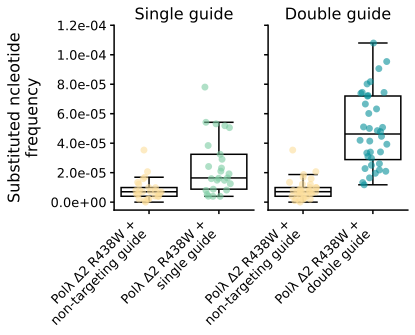

In [40]:
g = sns.FacetGrid(data_in_window_reshaped, col='Guide', sharex=False, height=3.5, aspect=0.75)
g.map_dataframe(sns.boxplot, y='AF', x='Sample', color='white', flierprops={'alpha':0}, medianprops={'color':'k'}, linewidth=1.5,
               boxprops={'edgecolor':'k'}, whiskerprops={'color':'k'}, capprops={'color':'k'})
g.map_dataframe(sns.stripplot, y='AF', x='Sample', hue='Sample', palette=colors_bx, legend=False, alpha=0.6, jitter=0.2, size=7)
    
for ax in g.axes.flat:
    ax.set_ylim(top=0.00012)
    ax.set_title(ax_title[ax.get_title()], size=16)
    ax.set_xticks(ax.get_xticks())
    ax.set_xticklabels([titles_1[x.get_text()].replace('+', '+') for x in ax.get_xticklabels()])
    for x in ax.get_xticklabels():
        x.set_rotation(45)
        x.set_ha('right')
        x.set_size(13)
    for y in ax.get_yticklabels():
        y.set_size(13)
    ax.spines['bottom'].set_linewidth(1.5)
    ax.spines['left'].set_linewidth(1.5)
    ax.tick_params(width=1.5, length=4)
    ax.set_ylabel('Substituted ncleotide\nfrequency', size=16, labelpad=10)
    ax.set_xlabel('')
    ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.1e'))
    
    #_ = axes.set_xticklabels([x.get_text().replace('GFP-', '').split('_')[0] for x in axes.get_xticklabels()])
#     for y in range(3,7):
#         axes.hlines(10**(-y), -1, 6, color='k', linestyle='--', alpha=0.3, linewidth=1)

#plt.yscale('symlog', linthreshy=1e-6)
plt.show()

In [48]:
data_in_window_reshaped.groupby(['Sample', 'Guide'])['AF'].max()

Sample        Guide
GFP-1-B_S3    1+B      0.000108
GFP-1_S2      1        0.000078
GFP-EMPTY_S1  1        0.000035
              1+B      0.000035
Name: AF, dtype: float64

In [113]:
data_in_window_reshaped.groupby(['Sample', 'Guide'])['AF'].mean()

Sample        Guide
GFP-1-B_S3    1+B      0.000049
GFP-1_S2      1        0.000024
GFP-EMPTY_S1  1        0.000009
              1+B      0.000008
Name: AF, dtype: float64

In [114]:
UMI_5_pileup_data['GFP-EMPTY_S1'][ampl_coords[ampl_name][0]:ampl_coords[ampl_name][1]]['af'].mean()

1.883380694057023e-05

In [115]:
UMI_5_pileup_data['GFP-EMPTY_S1'][625-35:651+35]['af'].mean()

8.655018231202973e-06

## Make base substitution image

In [149]:
window_start = int(nick_sites['GFP-1-B_S3']['1'] - upstream_window + 0.5)
window_end = int(nick_sites['GFP-1-B_S3']['B'] + upstream_window + 0.5)
alt_base_count = {}
bases = ['A', 'G', 'T', 'C']
for f in UMI_5_pileup_data:
    alt_base_count[f] = {'og_'+b:{b2:0 for b2 in bases if b2!=b} for b in bases}
    for i in range(window_start, window_end):
            ref = UMI_5_pileup_data[f].loc[i, 'ref']
            for b in bases:
                if b!=ref:
                    alt_base_count[f]['og_'+ref][b] += UMI_5_pileup_data[f].loc[i, b]

In [150]:
alt_base_count = {f:pd.DataFrame(alt_base_count[f]).transpose().fillna(0)[
    ['A', 'G', 'T', 'C']] for f in alt_base_count}

In [151]:
alt_base_count['GFP-1-B_S3'].sum().sum()

1320.0

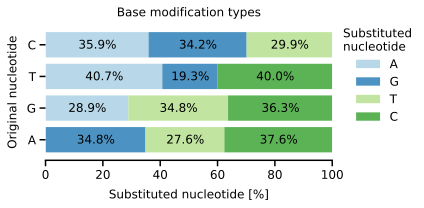

In [38]:
name = 'GFP-1-B_S3'
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(6, 3))
perc = alt_base_count[name].divide(alt_base_count[name].sum(axis=1), axis=0).multiply(100)
perc_cumsum = perc.apply(np.cumsum, axis=1)

ax = perc.plot(kind='barh', stacked=True, width=0.8, ax=ax, legend=False, alpha=0.8,
               #color = ['#fdae61', '#d7191c', '#abd9e9', '#2c7bb6']) # red and blue
               #color = ['#80cdc1', '#018571', '#dfc27d', '#a6611a']) # orange and green
               color = ['#a6cee3', '#1f78b4', '#b2df8a', '#33a02c']) # blue and green
               #color = ['#fdb863', '#e66101', '#b2abd2', '#5e3c99']) # orange and purple
               #color = ['#fcde9c', '#7ccba2', '#089099', '#045275']) # green gradient
               #color = ['#fcde9c', '#f0746e', '#dc3977', '#7c1d6f']) # red gradient
ax.set_title('Base modification types', size=12, pad=8)
ax.set_xlabel('Substituted nucleotide [%]', size=12, labelpad=8)

lgd = ax.legend(loc='upper left', bbox_to_anchor=(1, 1.05), frameon=False,
                title ='Substituted\nnucleotide', prop={'size':12}, ncol=1)
plt.setp(lgd.get_title(),fontsize='12')
ax.set_yticklabels([y.split('_')[1] for y in perc.index])

for y in ax.get_yticklabels():
    y.set_size(12)
for x in ax.get_xticklabels():
    x.set_size(12)
    x.set_rotation(0)
    
for jy,j in enumerate(perc.index):
    for ix,i in enumerate(perc.columns):
        if perc.loc[j, i]>0:
            x_base = perc_cumsum.loc[j].iloc[ix-1] if ix>0 else 0
            x = (perc_cumsum.loc[j, i]+x_base)/2
            ax.text(x-6.5, jy-0.12, '{:.1f}%'.format(perc.loc[j, i]), color='k',
                   size=12)

ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['bottom'].set_linewidth(1.5)

#ax.tick_params(axis='y', which='major', pad=80)
#ax.tick_params(left=False)
ax.tick_params(width=1.5, length=6)
    
ax.set_xlim(0,100)    
ax.set_ylabel('Original nucleotide', size=12, labelpad=8)
plt.tight_layout()
plt.show()
#plt.savefig('Figures/'+name+'_base_modification_types.svg')

## Make indel reads pileup

In [152]:
indel_pileup_files = glob(os.path.join(datadir, 'GFP*_pileup_indel_reads.tsv'))
indel_pileup_files.sort()
indel_pileup_files = indel_pileup_files[::-1]
indel_pileup_data = {f.split('/')[-1].replace('_pileup_indel_reads.tsv', ''):pd.read_csv(f, sep='\t', index_col=0) for f in indel_pileup_files}

In [153]:
def make_af_to_plot(pileup):
    af_to_plot = {'pos':[], 'A':[], 'C':[], 'G':[], 'T':[]}
    for i in pileup.index:
        for b in ['A', 'C', 'G', 'T']:
            if b != pileup.loc[i, 'ref'] and pileup.loc[i, 'cov']>1e2:
                af_to_plot[b].append(pileup.loc[i, b]/pileup.loc[i, 'cov'])
            else:
                af_to_plot[b].append(0.0)
        af_to_plot['pos'].append(pileup.loc[i, 'pos'])
    return pd.DataFrame(af_to_plot).fillna(0)

In [154]:
af_to_plot = {f:make_af_to_plot(indel_pileup_data[f]) for f in indel_pileup_data}

In [155]:
titles = {
    'GFP-EMPTY_S1':'Polλ Δ2 R438W + non-targeting guide',
    'GFP-1_S2':'Polλ Δ2 R438W + single guide',
    'GFP-1-B_S3':'Polλ Δ2 R438W + double guides'
}

In [43]:
fig, ax = plt.subplots(nrows=2, ncols=1, figsize=(10, 4.5))

for n,f in enumerate(['GFP-1_S2', 'GFP-1-B_S3']):
    af_to_plot[f][['A', 'C', 'G', 'T']].plot(kind='bar', stacked=True, ax=ax[n], legend=False, width=1,
                                             #color = ['#f8766d', '#7cae00', '#00bfc4','#c77cff']) original
                                             #color = ['#fdae61', '#d7191c', '#abd9e9', '#2c7bb6']) # red and blue
                                             #color = ['#fcde9c', '#7ccba2', '#089099', '#045275']) # green gradient
                                             #color = ['#fcde9c', '#f0746e', '#dc3977', '#7c1d6f']) # red gradient
                                             color = ['#a6cee3', '#1f78b4', '#b2df8a', '#33a02c']) # blue and green
    ymax = 0.075
    ax[n].set_ylim(0, ymax)
    ax[n].set_xlim(625-35, 651+35)
    ax[n].set_xticks([i for i in range(625-35, 651+35, 20)])
    ax[n].set_xticklabels([i for i in range(625-35, 651+35, 20)], size=12, rotation=0)
    for y in ax[n].get_yticklabels():
        y.set_size(12)
    ax[n].set_title(titles[f], size=12, pad=10)
    ax[n].spines['right'].set_visible(False)
    ax[n].spines['left'].set_linewidth(1.5)
    ax[n].spines['top'].set_visible(False)
    ax[n].spines['bottom'].set_linewidth(1.5)
    ax[n].tick_params(width=1.5, length=4)
    ax[n].set_ylabel('N', size=12, labelpad=20, color='white')
    guide_names = guides_by_sample[f]
    for guide_name in guide_names:
        nick = nick_sites[f][guide_name]
        if n!=0:
            nick_l = ax[n].vlines(nick, 0, ymax, color='k', linestyle='--', label='Nick site')
        else:
            ax[n].vlines(nick, 0, ymax, color='k', linestyle='--')

lgd = ax[0].legend(loc='upper left', bbox_to_anchor=(1.03, 1.2),
                title ='Substituted\nnucleotide', prop={'size':12}, ncol=1, frameon=False)
plt.setp(lgd.get_title(),fontsize='12')

ax[1].legend(handles = [nick_l], loc='upper left', bbox_to_anchor=(1.03, 1.4), prop={'size':12}, ncol=1, frameon=False)
ax[-1].set_xlabel('Position', size=12, labelpad=10)   
plt.tight_layout()
plt.text(580, 0.09, 'Nucleotide frequency', size=12, horizontalalignment='center', verticalalignment='center', rotation='vertical')
plt.subplots_adjust(hspace=0.45)
plt.show()

### Compute af in quantification window

In [196]:
data_by_UMI_depth_indel = {5:indel_pileup_data}

In [197]:
UMI_depth = 5

In [198]:
data_in_window = {g:{} for g in ['1', '1+B']}
for f in data_by_UMI_depth_indel[UMI_depth]:
    if f in nick_sites:
        for g in data_in_window:
            if 'B' not in nick_sites[f]:
                if g in nick_sites[f]:
                    nick = int(nick_sites[f][g]+0.5)
                    data_in_window[g][control] = data_by_UMI_depth_indel[UMI_depth][control][nick-upstream_window:nick+downstream_window]['af']
                    data_in_window[g][f] = data_by_UMI_depth_indel[UMI_depth][f][nick-upstream_window:nick+downstream_window]['af']
            else:
                if g=='1+B' and 'B' in f:
                    data_in_window[g][control] = data_by_UMI_depth_indel[UMI_depth][control][
                        int(nick_sites[f]['1']+0.5-upstream_window):int(nick_sites[f]['B']+0.5+upstream_window)]['af']
                    data_in_window[g][f] = data_by_UMI_depth_indel[UMI_depth][f][
                        int(nick_sites[f]['1']+0.5-upstream_window):int(nick_sites[f]['B']+0.5+upstream_window)]['af']

In [199]:
data_in_window = {g:pd.DataFrame(data_in_window[g]) for g in data_in_window}

In [200]:
data_in_window['1'].shape[0], data_in_window['1+B'].shape[0]

(25, 36)

In [201]:
data_in_window_reshaped = pd.concat([data_in_window[g].melt().assign(guide=[g]*data_in_window[g].melt().shape[0]) for g in data_in_window])

In [202]:
data_in_window_reshaped.columns = ['Sample', 'AF', 'Guide']

In [204]:
data_in_window_reshaped.groupby(['Sample', 'Guide'])['AF'].mean()

Sample        Guide
GFP-1-B_S3    1+B      0.007625
GFP-1_S2      1        0.025214
GFP-EMPTY_S1  1        0.001600
              1+B      0.003426
Name: AF, dtype: float64

## Make Fig. 3

In [205]:
datadir = 'pileups_indels/'

ampl_name = 'GFP'

indel_counts = pd.read_csv(os.path.join(datadir, '{}_indel_read_counts_UMI_5.tsv'.format(ampl_name)), sep='\t', index_col=0)
indel_counts.loc[['GFP-EMPTY_S1', 'GFP-1_S2', 'GFP-1-B_S3']]

,Insertions,Deletions
GFP-EMPTY_S1,1,24
GFP-1_S2,1085,5098
GFP-1-B_S3,42156,153966


In [206]:
insertion_files = glob(os.path.join(datadir, 'GFP*_insertions_by_UMI_5.tsv.bz2'))
insertion_files.sort()
insertion_files = insertion_files[::-1]

insertion_data = {f.split('/')[-1].replace('_insertions_by_UMI_5.tsv.bz2', ''):pd.read_csv(bz2.open(f, 'rt'), sep='\t', index_col=0)
                 for f in insertion_files}

In [207]:
deletion_files = glob(os.path.join(datadir, 'GFP*_deletions_by_UMI_5.tsv.bz2'))
deletion_files.sort()
deletion_files = deletion_files[::-1]

deletion_data = {f.split('/')[-1].replace('_deletions_by_UMI_5.tsv.bz2', ''):pd.read_csv(bz2.open(f, 'rt'), sep='\t', index_col=0)
                 for f in deletion_files}

In [208]:
insertion_data = {f:insertion_data[f]['0'].apply(eval) for f in ['GFP-EMPTY_S1', 'GFP-1_S2', 'GFP-1-B_S3']}
deletion_data = {f:deletion_data[f]['0'].apply(eval) for f in ['GFP-EMPTY_S1', 'GFP-1_S2', 'GFP-1-B_S3']}

In [209]:
UMI_counts = pd.read_csv('UMI_indel_ratio.tsv', sep='\t', index_col=0)

In [210]:
deletion_data_counts = {}
for f in deletion_data:
    deletion_data_counts[f] = []
    for pos in deletion_data[f].index:
        for UMI in deletion_data[f].loc[pos]:
            for i in range(pos, pos+deletion_data[f].loc[pos][UMI]):
                deletion_data_counts[f].append(i)

deletion_data_counts = {f:pd.Series(Counter(deletion_data_counts[f])) for f in deletion_data_counts}
for f in deletion_data_counts:
    for i in range(*ampl_coords[ampl_name]):
        if i not in deletion_data_counts[f].index:
            deletion_data_counts[f].loc[i] = 0
deletion_data_counts = {f:deletion_data_counts[f].sort_index() for f in deletion_data_counts}

In [211]:
control = 'GFP-EMPTY_S1'

In [212]:
indel_window = 20

In [213]:
nick_sites = {f:{g:int(nick_sites[f][g]+0.5) for g in nick_sites[f]} for f in nick_sites}

In [214]:
insertions_in_window = {g:{} for g in ['1', '1+B']}
deletions_in_window = {g:{} for g in ['1', '1+B']}
for f in insertion_data:
    for g in insertions_in_window:
        if 'B' not in nick_sites[f]:
            if g in nick_sites[f]:
                nick = nick_sites[f][g]
                insertions_in_window[g][control] = set(np.unique([UMI for pos_data in insertion_data[control][
                    nick-indel_window:nick+indel_window].values for UMI in pos_data]))
                insertions_in_window[g][f] = set(np.unique([UMI for pos_data in insertion_data[f][
                    nick-indel_window:nick+indel_window].values for UMI in pos_data]))
                
                deletions_in_window[g][control] = set(np.unique([UMI for pos in deletion_data[control].index
                    for UMI in deletion_data[control].loc[pos] if pos<nick+indel_window and pos+deletion_data[control].loc[pos][
                        UMI]>nick-indel_window]))
                deletions_in_window[g][f] = set(np.unique([UMI for pos in deletion_data[f].index
                    for UMI in deletion_data[f].loc[pos] if pos<nick+indel_window and pos+deletion_data[f].loc[pos][
                        UMI]>nick-indel_window]))
        else:
            if g=='1+B' and 'B' in f:
                insertions_in_window[g][control] = set(np.unique([UMI for pos_data in insertion_data[control][
                    nick_sites[f]['1']-indel_window:nick_sites[f]['B']+indel_window].values for UMI in pos_data]))
                insertions_in_window[g][f] = set(np.unique([UMI for pos_data in insertion_data[f][
                    nick_sites[f]['1']-indel_window:nick_sites[f]['B']+indel_window].values for UMI in pos_data]))
                
                deletions_in_window[g][control] = set(np.unique([UMI for pos in deletion_data[control].index
                    for UMI in deletion_data[control].loc[pos] if pos<nick_sites[f]['B']+indel_window and pos+deletion_data[
                        control].loc[pos][UMI]>nick_sites[f]['1']-indel_window]))
                deletions_in_window[g][f] = set(np.unique([UMI for pos in deletion_data[f].index for UMI in deletion_data[f].loc[pos]
                    if pos<nick_sites[f]['B']+indel_window and pos+deletion_data[f].loc[pos][UMI]>nick_sites[f]['1']-indel_window]))

In [215]:
indel_in_window_UMIs = {g:{f:[UMI for UMI in insertions_in_window[g][f] if UMI in deletions_in_window[g][f]]
                               for f in insertions_in_window[g]} for g in insertions_in_window}
insertions_in_window_UMIs = {g:{f:[UMI for UMI in insertions_in_window[g][f] if UMI not in deletions_in_window[g][f]]
                               for f in insertions_in_window[g]} for g in insertions_in_window}
deletions_in_window_UMIs = {g:{f:[UMI for UMI in deletions_in_window[g][f] if UMI not in insertions_in_window[g][f]]
                               for f in insertions_in_window[g]} for g in insertions_in_window}

In [216]:
indel_in_window_fraction = {g:{f:len([UMI for UMI in insertions_in_window[g][f] if UMI in deletions_in_window[g][f]])/UMI_counts.loc[f, 'Total']
                               for f in insertions_in_window[g]} for g in insertions_in_window}
insertions_in_window_fraction = {g:{f:len([UMI for UMI in insertions_in_window[g][f] if UMI not in deletions_in_window[g][f]])/UMI_counts.loc[f, 'Total']
                               for f in insertions_in_window[g]} for g in insertions_in_window}
deletions_in_window_fraction = {g:{f:len([UMI for UMI in deletions_in_window[g][f] if UMI not in insertions_in_window[g][f]])/UMI_counts.loc[f, 'Total']
                               for f in insertions_in_window[g]} for g in insertions_in_window}

In [217]:
indel_fract = {g:{f:pd.Series([deletions_in_window_fraction[g][f], insertions_in_window_fraction[g][f], indel_in_window_fraction[g][f]],
    index=['Deletions', 'Insertions', 'Insertions and\nDeletions']) for f in insertions_in_window_fraction[g]} 
    for g in insertions_in_window_fraction}

In [218]:
for g in indel_fract:
    for f in indel_fract[g]:
        indel_fract[g][f]['No Indels'] = 1-indel_fract[g][f].sum()

In [219]:
indel_fract_dfs = {g:pd.DataFrame(indel_fract[g]) for g in indel_fract}

In [220]:
to_plot = pd.concat([indel_fract_dfs['1+B']['GFP-EMPTY_S1'], indel_fract_dfs['1']['GFP-1_S2'], indel_fract_dfs['1+B']['GFP-1-B_S3']], axis=1)

In [221]:
to_plot

,GFP-EMPTY_S1,GFP-1_S2,GFP-1-B_S3
Deletions,0.000002,0.004405,0.153402
Insertions,0.000000,0.000596,0.037900
Insertions and\nDeletions,0.000000,0.000378,0.005527
No Indels,0.999998,0.994621,0.803171


In [181]:
palette = {'HIV-1 RT':'#fcde9c',
           'Polλ Δ2':'#7ccba2',
           'Polλ Δ2 R438W':'#089099',
           'Polλ Δ2 R438W\n+ MLH1dn':'#045275'}

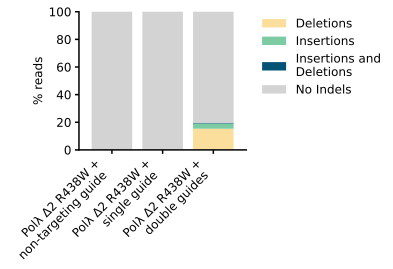

In [62]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(3, 2.5))


to_plot.transpose().multiply(100).plot(kind='bar', stacked=True, legend=False, ax=ax, width=0.8,
                                       color = ['lightgray', '#045275', '#7ccba2', '#fcde9c'][::-1])
                                       #color = ['lightgray', 'purple', 'lightskyblue', 'tomato'][::-1])

ax.set_xticklabels([titles[x.get_text()].replace('+', '+\n') for x in ax.get_xticklabels()], rotation = 45, ha='right', size=12)
ax.set_ylabel('% reads', size=12)
lgd = ax.legend(loc='upper left', bbox_to_anchor=(1.03, 1.03), frameon=False, title ='', prop={'size':12}, ncol=1)

ax.set_ylim(0,100)
#ax.set_yscale('symlog', linthresh=0.01)
for y in ax.get_yticklabels():
    y.set_size(12)
ax.spines['bottom'].set_linewidth(1.5)
ax.spines['left'].set_linewidth(1.5)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.tick_params(width=1.5, length=4)

plt.show()

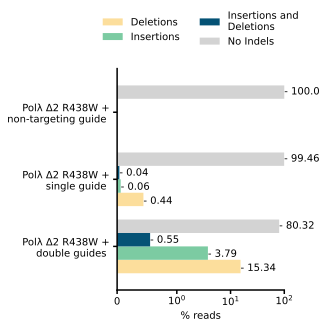

In [63]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(3, 4))

to_plot_rescaled = to_plot.transpose().multiply(100)[::-1]
to_plot_rescaled.plot(kind='barh', legend=False, ax=ax, width=0.8,
               color = ['lightgray', '#045275', '#7ccba2', '#fcde9c'][::-1])
               #color = ['lightgray', 'purple', 'lightskyblue', 'tomato'][::-1])

ax.set_yticklabels([titles[x.get_text()].replace('+', '+\n') for x in ax.get_yticklabels()], size=10)
ax.set_xlabel('% reads', size=10)
lgd = ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), frameon=False, title ='', prop={'size':10}, ncol=2)

for yi, i in enumerate(to_plot_rescaled.index):
    for xc, c in enumerate(to_plot_rescaled.columns):
        y = yi+(xc-1.5)*0.21-0.05
        x = to_plot_rescaled.loc[i, c]
        if round(to_plot_rescaled.loc[i, c], 2) > 0:
            ax.text(x, y, '-  {}'.format(round(to_plot_rescaled.loc[i, c], 2)))

ax.set_xlim(0,100)
ax.set_xscale('symlog', linthresh=1)
# #ax.set_yscale('symlog', linthresh=0.01)
# for y in ax.get_yticklabels():
#     y.set_size(12)
ax.spines['bottom'].set_linewidth(1.5)
ax.spines['left'].set_linewidth(1.5)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.tick_params(width=1.5, length=4)

plt.show()

## Supplementary figures

In [223]:
UMI_depth = 1

In [224]:
data_in_window = {g:{} for g in ['1', '1+B']}
for f in data_by_UMI_depth[UMI_depth]:
    for g in data_in_window:
        if 'B' not in nick_sites[f]:
            if g in nick_sites[f]:
                nick = int(nick_sites[f][g]+0.5)
                data_in_window[g][control] = data_by_UMI_depth[UMI_depth][control][nick-upstream_window:nick+downstream_window]['af']
                data_in_window[g][f] = data_by_UMI_depth[UMI_depth][f][nick-upstream_window:nick+downstream_window]['af']
        else:
            if g=='1+B' and 'B' in f:
                data_in_window[g][control] = data_by_UMI_depth[UMI_depth][control][
                    int(nick_sites[f]['1']+0.5-upstream_window):int(nick_sites[f]['B']+0.5+upstream_window)]['af']
                data_in_window[g][f] = data_by_UMI_depth[UMI_depth][f][
                    int(nick_sites[f]['1']+0.5-upstream_window):int(nick_sites[f]['B']+0.5+upstream_window)]['af']

In [225]:
data_in_window = {g:pd.DataFrame(data_in_window[g]) for g in data_in_window}

In [226]:
data_in_window['1'].shape[0], data_in_window['1+B'].shape[0]

(25, 36)

In [227]:
data_in_window_reshaped = pd.concat([data_in_window[g].melt().assign(guide=[g]*data_in_window[g].melt().shape[0]) for g in data_in_window])

In [228]:
data_in_window_reshaped.columns = ['Sample', 'AF', 'Guide']

In [231]:
data_in_window_reshaped.to_csv('GFP_pileup_raw_AF_melted.tsv', sep='\t', index=False)

In [230]:
3.5*0.75

2.625

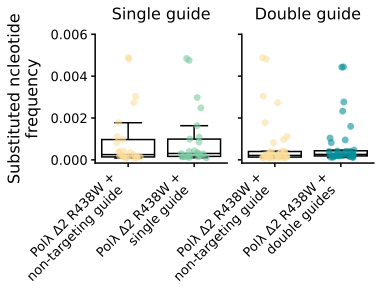

In [154]:
g = sns.FacetGrid(data_in_window_reshaped, col='Guide', sharex=False, height=2.7, aspect=0.9)
g.map_dataframe(sns.boxplot, y='AF', x='Sample', color='white', flierprops={'alpha':0}, medianprops={'color':'k'}, linewidth=1.5,
               boxprops={'edgecolor':'k'}, whiskerprops={'color':'k'}, capprops={'color':'k'})
g.map_dataframe(sns.stripplot, y='AF', x='Sample', hue='Sample', palette=colors_bx, legend=False, alpha=0.6, jitter=0.2, size=7)
    
for ax in g.axes.flat:
    ax.set_ylim(top=0.006)
    ax.set_title(ax_title[ax.get_title()], size=16, pad=15)
    ax.set_xticks(ax.get_xticks())
    ax.set_xticklabels([titles[x.get_text()].replace('+', '+\n') for x in ax.get_xticklabels()])
    for x in ax.get_xticklabels():
        x.set_rotation(45)
        x.set_ha('right')
        x.set_size(13)
    for y in ax.get_yticklabels():
        y.set_size(13)
    ax.spines['bottom'].set_linewidth(1.5)
    ax.spines['left'].set_linewidth(1.5)
    ax.tick_params(width=1.5, length=4)
    ax.set_ylabel('Substituted ncleotide\nfrequency', size=16, labelpad=10)
    ax.set_xlabel('')
#    ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.1e'))
    
plt.show()

In [75]:
data_in_window_reshaped.groupby(['Sample', 'Guide'])['AF'].mean()

Sample        Guide
GFP-1-B_S3    1+B      0.000702
GFP-1_S2      1        0.000938
GFP-EMPTY_S1  1        0.000947
              1+B      0.000718
Name: AF, dtype: float64

In [84]:
raw_pileup_data['GFP-EMPTY_S1'][ampl_coords[ampl_name][0]:ampl_coords[ampl_name][1]]['af'].mean()

0.0003126702526376657

In [89]:
raw_pileup_data['GFP-EMPTY_S1'][625-35:651+35]['af'].mean()

0.0004949150135490113

In [107]:
window_start = int(nick_sites['GFP-1_S2']['1'] - upstream_window + 0.5)
window_end = int(nick_sites['GFP-1_S2']['1'] + downstream_window + 0.5)
alt_base_count = {}
bases = ['A', 'G', 'T', 'C']
for f in UMI_5_pileup_data:
    alt_base_count[f] = {'og_'+b:{b2:0 for b2 in bases if b2!=b} for b in bases}
    for i in range(window_start, window_end):
            ref = UMI_5_pileup_data[f].loc[i, 'ref']
            for b in bases:
                if b!=ref:
                    alt_base_count[f]['og_'+ref][b] += UMI_5_pileup_data[f].loc[i, b]

In [108]:
alt_base_count = {f:pd.DataFrame(alt_base_count[f]).transpose().fillna(0)[
    ['A', 'G', 'T', 'C']] for f in alt_base_count}

In [109]:
alt_base_count['GFP-1_S2'].sum().sum()

616.0

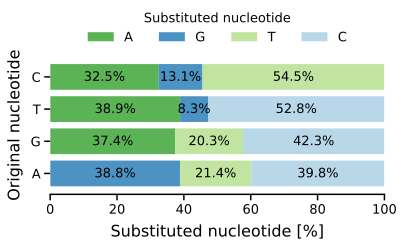

In [149]:
name = 'GFP-1_S2'
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(6, 2.5))
perc = alt_base_count[name].divide(alt_base_count[name].sum(axis=1), axis=0).multiply(100)
perc_cumsum = perc.apply(np.cumsum, axis=1)

ax = perc.plot(kind='barh', stacked=True, width=0.8, ax=ax, legend=False, alpha=0.8,
               #color = ['#fdae61', '#d7191c', '#abd9e9', '#2c7bb6']) # red and blue
               #color = ['#80cdc1', '#018571', '#dfc27d', '#a6611a']) # orange and green
               color = ['#33a02c', '#1f78b4', '#b2df8a', '#a6cee3']) # blue and green
               #color = ['#fdb863', '#e66101', '#b2abd2', '#5e3c99']) # orange and purple
               #color = ['#fcde9c', '#7ccba2', '#089099', '#045275']) # green gradient
               #color = ['#fcde9c', '#f0746e', '#dc3977', '#7c1d6f']) # red gradient
#ax.set_title('Base modification types', size=12, pad=8)
ax.set_xlabel('Substituted nucleotide [%]', size=16, labelpad=8)

lgd = ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.4), frameon=False,
                title ='Substituted nucleotide', prop={'size':13}, ncol=4)
plt.setp(lgd.get_title(),fontsize='13')
ax.set_yticklabels([y.split('_')[1] for y in perc.index])

for y in ax.get_yticklabels():
    y.set_size(13)
for x in ax.get_xticklabels():
    x.set_size(13)
    x.set_rotation(0)
    
for jy,j in enumerate(perc.index):
    for ix,i in enumerate(perc.columns):
        if perc.loc[j, i]>0:
            x_base = perc_cumsum.loc[j].iloc[ix-1] if ix>0 else 0
            x = (perc_cumsum.loc[j, i]+x_base)/2
            ax.text(x, jy-0.12, '{:.1f}%'.format(perc.loc[j, i]), color='k', horizontalalignment='center',
                   size=13)

ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['bottom'].set_linewidth(1.5)

ax.tick_params(width=1.5, length=6)
    
ax.set_xlim(0,100)    
ax.set_ylabel('Original nucleotide', size=16, labelpad=8)
#plt.tight_layout()
plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


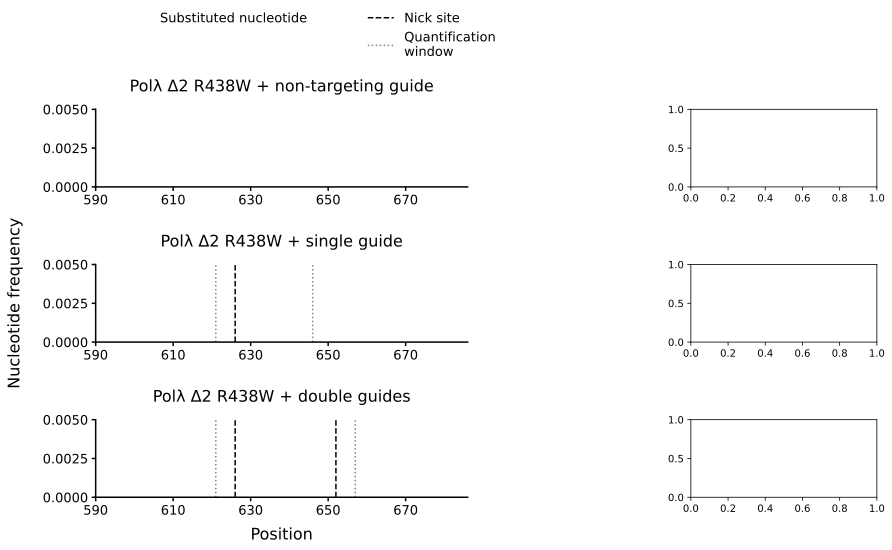

In [132]:
fig, axs = plt.subplots(ncols=2, nrows=3, figsize=(14, 7),
                        gridspec_kw={'width_ratios':[2,1], 'height_ratios':[1,1,1]})

font_size = 16
lgnd_size = 13

########################################################################################################
# RAW PILEUP

ax = axs[0:3, 0]

af_to_plot = {f:make_af_to_plot(raw_pileup_data[f]) for f in raw_pileup_data}
for n,f in enumerate(raw_pileup_data):
    # af_to_plot[f][['A', 'G', 'T', 'C']].plot(kind='bar', stacked=True, ax=ax[n], legend=False, width=1,
    #                                          #color = ['#fdae61', '#d7191c', '#abd9e9', '#2c7bb6']) # red and blue
    #                                          #color = ['#fcde9c', '#7ccba2', '#089099', '#045275']) # green gradient
    #                                          #color = ['#fcde9c', '#f0746e', '#dc3977', '#7c1d6f']) # red gradient
    #                                          color = ['#33a02c', '#1f78b4', '#b2df8a', '#a6cee3']) # blue and green
    ymax = 0.005
    ax[n].set_ylim(0, ymax)
    ax[n].set_xlim(625-35, 651+35)
    ax[n].set_xticks([i for i in range(625-35, 651+35, 20)])
    ax[n].set_xticklabels([i for i in range(625-35, 651+35, 20)], size=lgnd_size, rotation=0)
    ax[n].set_yticks([0, 2.5e-3, 5e-3])
    for y in ax[n].get_yticklabels():
        y.set_size(lgnd_size)
    ax[n].set_title(titles[f], size=font_size, pad=18)
    ax[n].spines['right'].set_visible(False)
    ax[n].spines['left'].set_linewidth(1.5)
    ax[n].spines['top'].set_visible(False)
    ax[n].spines['bottom'].set_linewidth(1.5)
    ax[n].tick_params(width=1.5, length=4)
    #ax[n].set_ylabel('', size=12, labelpad=20, color='white')
    guide_names = guides_by_sample[f]
    for guide_name in guide_names:
        nick = nick_sites[f][guide_name]
        nick_l = ax[n].vlines(nick, 0, ymax, color='k', linestyle='--', label='Nick site')
        if 'B' not in guide_names:
            ax[n].vlines(nick-upstream_window, 0, ymax, color='gray', linestyle='dotted')
            ax[n].vlines(nick+downstream_window, 0, ymax, color='gray', linestyle='dotted')
        else:
            if guide_name=='B':
                qw_l = ax[n].vlines(nick+upstream_window, 0, ymax, color='gray', linestyle='dotted', label='Quantification\nwindow')
            else:
                ax[n].vlines(nick-upstream_window, 0, ymax, color='gray', linestyle='dotted')

lgd = ax[0].legend(loc='upper right', bbox_to_anchor=(0.6, 2.4),
                title ='Substituted nucleotide', prop={'size':lgnd_size}, ncol=4, frameon=False)
plt.setp(lgd.get_title(),fontsize=str(lgnd_size))

ax[1].legend(handles = [nick_l, qw_l], loc='upper left', bbox_to_anchor=(0.7, 4.4), prop={'size':lgnd_size}, ncol=1, frameon=False)

ax[-1].set_xlabel('Position', size=font_size, labelpad=10)
ax[1].set_ylabel('Nucleotide frequency', size=font_size, labelpad=20)

plt.subplots_adjust(wspace=0.8, hspace=1)
plt.show()

## Supplementary figure

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


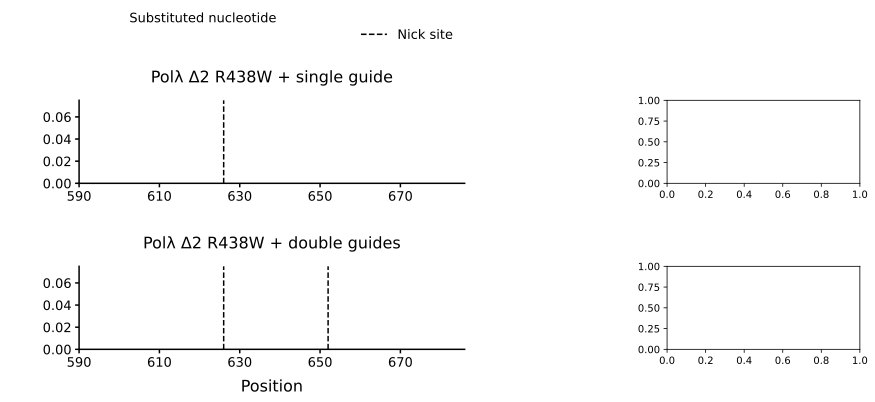

In [178]:
fig, axs = plt.subplots(ncols=2, nrows=2, figsize=(14, 4.5),
                        gridspec_kw={'width_ratios':[2,1], 'height_ratios':[1,1]})

font_size = 16
lgnd_size = 13

########################################################################################################
# RAW PILEUP

ax = axs[0:2, 0]

af_to_plot = {f:make_af_to_plot(indel_pileup_data[f]) for f in indel_pileup_data}
for n,f in enumerate(['GFP-1_S2', 'GFP-1-B_S3']):
    # af_to_plot[f][['A', 'C', 'G', 'T']].plot(kind='bar', stacked=True, ax=ax[n], legend=False, width=1,
    #                                          #color = ['#f8766d', '#7cae00', '#00bfc4','#c77cff']) original
    #                                          #color = ['#fdae61', '#d7191c', '#abd9e9', '#2c7bb6']) # red and blue
    #                                          #color = ['#fcde9c', '#7ccba2', '#089099', '#045275']) # green gradient
    #                                          #color = ['#fcde9c', '#f0746e', '#dc3977', '#7c1d6f']) # red gradient
    #                                          color = ['#a6cee3', '#1f78b4', '#b2df8a', '#33a02c']) # blue and green
    ymax = 0.075
    ax[n].set_ylim(0, ymax)
    ax[n].set_xlim(625-35, 651+35)
    ax[n].set_xticks([i for i in range(625-35, 651+35, 20)])
    ax[n].set_xticklabels([i for i in range(625-35, 651+35, 20)], size=lgnd_size, rotation=0)
    for y in ax[n].get_yticklabels():
        y.set_size(lgnd_size)
    ax[n].set_title(titles[f], size=font_size, pad=18)
    ax[n].spines['right'].set_visible(False)
    ax[n].spines['left'].set_linewidth(1.5)
    ax[n].spines['top'].set_visible(False)
    ax[n].spines['bottom'].set_linewidth(1.5)
    ax[n].tick_params(width=1.5, length=4)
    ax[n].set_ylabel('Nucleotide frequency', size=font_size, labelpad=20, color='white')
    guide_names = guides_by_sample[f]
    for guide_name in guide_names:
        nick = nick_sites[f][guide_name]
        if n!=0:
            nick_l = ax[n].vlines(nick, 0, ymax, color='k', linestyle='--', label='Nick site')
        else:
            ax[n].vlines(nick, 0, ymax, color='k', linestyle='--')

lgd = ax[0].legend(loc='upper left', bbox_to_anchor=(0.1, 2.2),
                title ='Substituted nucleotide', prop={'size':lgnd_size}, ncol=4, frameon=False)
plt.setp(lgd.get_title(),fontsize=str(lgnd_size))

ax[1].legend(handles = [nick_l], loc='upper right', bbox_to_anchor=(1, 4), prop={'size':lgnd_size}, ncol=1, frameon=False)
ax[-1].set_xlabel('Position', size=font_size, labelpad=10)

plt.subplots_adjust(wspace=0.7, hspace=1)
plt.show()

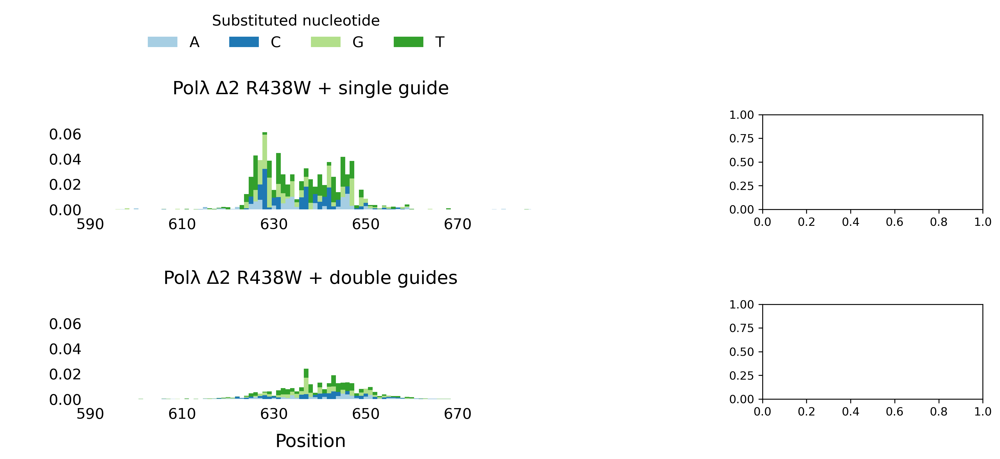

In [183]:
fig, axs = plt.subplots(ncols=2, nrows=2, figsize=(14, 4.5),
                        gridspec_kw={'width_ratios':[2,1], 'height_ratios':[1,1]})

font_size = 16
lgnd_size = 13

########################################################################################################
# RAW PILEUP

ax = axs[0:2, 0]

af_to_plot = {f:make_af_to_plot(indel_pileup_data[f]) for f in indel_pileup_data}
for n,f in enumerate(['GFP-1_S2', 'GFP-1-B_S3']):
    af_to_plot[f][['A', 'C', 'G', 'T']].plot(kind='bar', stacked=True, ax=ax[n], legend=False, width=1,
                                             #color = ['#f8766d', '#7cae00', '#00bfc4','#c77cff']) original
                                             #color = ['#fdae61', '#d7191c', '#abd9e9', '#2c7bb6']) # red and blue
                                             #color = ['#fcde9c', '#7ccba2', '#089099', '#045275']) # green gradient
                                             #color = ['#fcde9c', '#f0746e', '#dc3977', '#7c1d6f']) # red gradient
                                             color = ['#a6cee3', '#1f78b4', '#b2df8a', '#33a02c']) # blue and green
    ymax = 0.075
    ax[n].set_ylim(0, ymax)
    ax[n].set_xlim(625-35, 651+35)
    ax[n].set_xticks([i for i in range(625-35, 651+35, 20)])
    ax[n].set_xticklabels([i for i in range(625-35, 651+35, 20)], size=lgnd_size, rotation=0)
    for y in ax[n].get_yticklabels():
        y.set_size(lgnd_size)
    ax[n].set_title(titles[f], size=font_size, pad=18)
    ax[n].spines['right'].set_visible(False)
    ax[n].spines['left'].set_visible(False)
    ax[n].spines['top'].set_visible(False)
    ax[n].spines['bottom'].set_visible(False)
    ax[n].tick_params(width=0, length=4)
    ax[n].set_ylabel('Nucleotide frequency', size=font_size, labelpad=20, color='white')
    # guide_names = guides_by_sample[f]
    # for guide_name in guide_names:
    #     nick = nick_sites[f][guide_name]
    #     if n!=0:
    #         nick_l = ax[n].vlines(nick, 0, ymax, color='k', linestyle='--', label='Nick site')
    #     else:
    #         ax[n].vlines(nick, 0, ymax, color='k', linestyle='--')

lgd = ax[0].legend(loc='upper left', bbox_to_anchor=(0.1, 2.2),
                title ='Substituted nucleotide', prop={'size':lgnd_size}, ncol=4, frameon=False)
plt.setp(lgd.get_title(),fontsize=str(lgnd_size))

#ax[1].legend(handles = [nick_l], loc='upper right', bbox_to_anchor=(1, 4), prop={'size':lgnd_size}, ncol=1, frameon=False)
ax[-1].set_xlabel('Position', size=font_size, labelpad=10)

plt.subplots_adjust(wspace=0.7, hspace=1)
plt.show()

In [185]:
window_start = int(nick_sites['GFP-1-B_S3']['1'] - upstream_window + 0.5)
window_end = int(nick_sites['GFP-1-B_S3']['B'] + upstream_window + 0.5)
alt_base_count = {}
bases = ['A', 'C', 'G', 'T']
for f in indel_pileup_data:
    alt_base_count[f] = {'og_'+b:{b2:0 for b2 in bases if b2!=b} for b in bases}
    for i in range(window_start, window_end):
            ref = indel_pileup_data[f].loc[i, 'ref']
            for b in bases:
                if b!=ref:
                    alt_base_count[f]['og_'+ref][b] += indel_pileup_data[f].loc[i, b]

In [186]:
alt_base_count = {f:pd.DataFrame(alt_base_count[f]).transpose().fillna(0)[
    ['A', 'C', 'G', 'T']] for f in alt_base_count}

In [187]:
alt_base_count['GFP-1-B_S3'].sum().sum()

27216.0

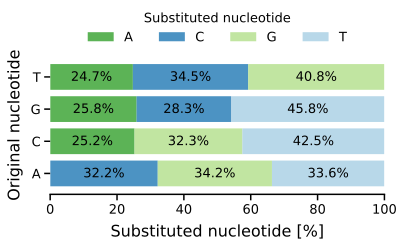

In [191]:
name = 'GFP-1-B_S3'
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(6, 2.5))
perc = alt_base_count[name].divide(alt_base_count[name].sum(axis=1), axis=0).multiply(100)
perc_cumsum = perc.apply(np.cumsum, axis=1)

ax = perc.plot(kind='barh', stacked=True, width=0.8, ax=ax, legend=False, alpha=0.8,
               #color = ['#fdae61', '#d7191c', '#abd9e9', '#2c7bb6']) # red and blue
               #color = ['#80cdc1', '#018571', '#dfc27d', '#a6611a']) # orange and green
               color = ['#33a02c', '#1f78b4', '#b2df8a', '#a6cee3']) # blue and green
               #color = ['#fdb863', '#e66101', '#b2abd2', '#5e3c99']) # orange and purple
               #color = ['#fcde9c', '#7ccba2', '#089099', '#045275']) # green gradient
               #color = ['#fcde9c', '#f0746e', '#dc3977', '#7c1d6f']) # red gradient
#ax.set_title('Base modification types', size=12, pad=8)
ax.set_xlabel('Substituted nucleotide [%]', size=16, labelpad=8)

lgd = ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.4), frameon=False,
                title ='Substituted nucleotide', prop={'size':13}, ncol=4)
plt.setp(lgd.get_title(),fontsize='13')
ax.set_yticklabels([y.split('_')[1] for y in perc.index])

for y in ax.get_yticklabels():
    y.set_size(13)
for x in ax.get_xticklabels():
    x.set_size(13)
    x.set_rotation(0)
    
for jy,j in enumerate(perc.index):
    for ix,i in enumerate(perc.columns):
        if perc.loc[j, i]>0:
            x_base = perc_cumsum.loc[j].iloc[ix-1] if ix>0 else 0
            x = (perc_cumsum.loc[j, i]+x_base)/2
            ax.text(x, jy-0.12, '{:.1f}%'.format(perc.loc[j, i]), color='k', horizontalalignment='center',
                   size=13)

ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['bottom'].set_linewidth(1.5)

ax.tick_params(width=1.5, length=6)
    
ax.set_xlim(0,100)    
ax.set_ylabel('Original nucleotide', size=16, labelpad=8)
#plt.tight_layout()
plt.show()

In [192]:
window_start = int(nick_sites['GFP-1_S2']['1'] - upstream_window + 0.5)
window_end = int(nick_sites['GFP-1_S2']['1'] + downstream_window + 0.5)
alt_base_count = {}
bases = ['A', 'C', 'G', 'T']
for f in indel_pileup_data:
    alt_base_count[f] = {'og_'+b:{b2:0 for b2 in bases if b2!=b} for b in bases}
    for i in range(window_start, window_end):
            ref = indel_pileup_data[f].loc[i, 'ref']
            for b in bases:
                if b!=ref:
                    alt_base_count[f]['og_'+ref][b] += indel_pileup_data[f].loc[i, b]

In [193]:
alt_base_count = {f:pd.DataFrame(alt_base_count[f]).transpose().fillna(0)[
    ['A', 'C', 'G', 'T']] for f in alt_base_count}

In [194]:
alt_base_count['GFP-1_S2'].sum().sum()

1392.0

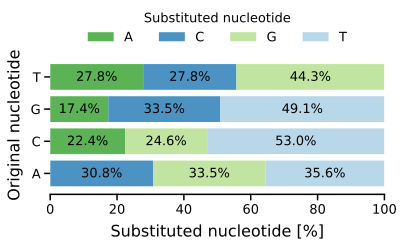

In [195]:
name = 'GFP-1_S2'
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(6, 2.5))
perc = alt_base_count[name].divide(alt_base_count[name].sum(axis=1), axis=0).multiply(100)
perc_cumsum = perc.apply(np.cumsum, axis=1)

ax = perc.plot(kind='barh', stacked=True, width=0.8, ax=ax, legend=False, alpha=0.8,
               #color = ['#fdae61', '#d7191c', '#abd9e9', '#2c7bb6']) # red and blue
               #color = ['#80cdc1', '#018571', '#dfc27d', '#a6611a']) # orange and green
               color = ['#33a02c', '#1f78b4', '#b2df8a', '#a6cee3']) # blue and green
               #color = ['#fdb863', '#e66101', '#b2abd2', '#5e3c99']) # orange and purple
               #color = ['#fcde9c', '#7ccba2', '#089099', '#045275']) # green gradient
               #color = ['#fcde9c', '#f0746e', '#dc3977', '#7c1d6f']) # red gradient
#ax.set_title('Base modification types', size=12, pad=8)
ax.set_xlabel('Substituted nucleotide [%]', size=16, labelpad=8)

lgd = ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.4), frameon=False,
                title ='Substituted nucleotide', prop={'size':13}, ncol=4)
plt.setp(lgd.get_title(),fontsize='13')
ax.set_yticklabels([y.split('_')[1] for y in perc.index])

for y in ax.get_yticklabels():
    y.set_size(13)
for x in ax.get_xticklabels():
    x.set_size(13)
    x.set_rotation(0)
    
for jy,j in enumerate(perc.index):
    for ix,i in enumerate(perc.columns):
        if perc.loc[j, i]>0:
            x_base = perc_cumsum.loc[j].iloc[ix-1] if ix>0 else 0
            x = (perc_cumsum.loc[j, i]+x_base)/2
            ax.text(x, jy-0.12, '{:.1f}%'.format(perc.loc[j, i]), color='k', horizontalalignment='center',
                   size=13)

ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['bottom'].set_linewidth(1.5)

ax.tick_params(width=1.5, length=6)
    
ax.set_xlim(0,100)    
ax.set_ylabel('Original nucleotide', size=16, labelpad=8)
#plt.tight_layout()
plt.show()